# 1D dMRI particle visualization (Signal magnitude + trajectories + animation)
This notebook implements the simulation we discussed:
- 1D domain with reflecting walls ±L/2
- 5 particles starting at x=0
- 7 symmetric D bins (center highest)
- Gradient waveform: +2 G/cm (30 ms), 0 (20 ms), -2 G/cm (30 ms)
- Midpoint phase update, robust reflections
- Stores full trajectories `x_traj` and `phi_traj` (for animation)
- Produces 4 static frames (t=0,30,50,80 ms) and an inline JS animation
- Particles colored by their **diffusivity bin index** (static color per particle)

In [10]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
from matplotlib import gridspec
from matplotlib.animation import FuncAnimation
from matplotlib.colors import Normalize
from IPython.display import HTML

plt.rcParams.update({
    "figure.figsize": (10, 6),
    "font.size": 10
})

# Cell 2: parameters (default)

In [11]:
# Units: cm, ms, Gauss, cm^2/ms
L = 0.004                # cm (domain width)
dt = 0.1                 # ms
T_total = 80.0           # ms
gamma = 26.75            # rad / (ms * Gauss)
G_pulse = 2.0            # Gauss/cm
seg_durations = [30.0, 20.0, 30.0]  # ms
n_spins = 50000
seed = 42

# spatial bins and diffusivities
edges = np.array([
    -L/2.0, -L/3.0, -L/6.0, -L/12.0,
     L/12.0, L/6.0,  L/3.0,  L/2.0
], dtype=float)

D_bins = np.array([1e-9, 2e-9, 4e-9, 8e-9, 4e-9, 2e-9, 1e-9], dtype=float)

snapshot_times = [0.0, 30.0, 50.0, 80.0]

n_steps = int(round(T_total / dt))
t_array = np.linspace(0.0, T_total, n_steps + 1)

# Cell 3: gradient waveform and diagnostics

In [12]:
def build_gradient_sequence(G_amp, seg_durations, dt, n_steps):
    seg_steps = [int(round(d / dt)) for d in seg_durations]
    G_list = np.concatenate([
        G_amp * np.ones(seg_steps[0]),
        np.zeros(seg_steps[1]),
        -G_amp * np.ones(seg_steps[2])
    ])
    if len(G_list) < n_steps + 1:
        padding = np.zeros((n_steps + 1) - len(G_list))
        G_list = np.concatenate([G_list, padding])
    elif len(G_list) > n_steps + 1:
        G_list = G_list[:n_steps + 1]
    return np.asarray(G_list, dtype=float)

G_t = build_gradient_sequence(G_pulse, seg_durations, dt, n_steps)

def diagnostics(D_bins, dt, L):
    step_sigmas = np.sqrt(2.0 * D_bins * dt)  # cm
    L_half_um = (L/2.0) * 1e4
    step_sigmas_um = step_sigmas * 1e4
    print("Diagnostics:")
    print(f"step_sigma per bin (µm): {step_sigmas_um}")
    print(f"domain half-width (µm): {L_half_um:.2f}")
    return step_sigmas

step_sigmas = diagnostics(D_bins, dt, L)

Diagnostics:
step_sigma per bin (µm): [0.14142136 0.2        0.28284271 0.4        0.28284271 0.2
 0.14142136]
domain half-width (µm): 20.00


# Cell 4: helper functions

In [13]:
def pos_to_bin_indices(x, edges):
    inds = np.digitize(x, edges) - 1
    inds = np.clip(inds, 0, len(edges) - 2)
    return inds

def reflect_positions(x, left, right):
    out_left = x < left
    out_right = x > right
    while (out_left.any() or out_right.any()):
        if out_left.any():
            x[out_left] = 2*left - x[out_left]
        if out_right.any():
            x[out_right] = 2*right - x[out_right]
        out_left = x < left
        out_right = x > right
    return x

def compute_bin_signals_at_end(res, edges):
    x_traj = res["x_traj"]
    phi_traj = res["phi_traj"]
    x_end = x_traj[-1, :]
    phi_end = phi_traj[-1, :]
    inds_end = pos_to_bin_indices(x_end, edges)
    n_bins = len(edges) - 1
    S_bins = np.zeros(n_bins, dtype=complex)
    for b in range(n_bins):
        mask = (inds_end == b)
        if np.any(mask):
            S_bins[b] = np.mean(np.exp(1j * phi_end[mask]))
        else:
            S_bins[b] = np.nan + 0j
    return S_bins, np.abs(S_bins)

# Cell 5: main simulation (stores full trajectories)

In [14]:
def simulate_1d_diffusion_store(L, dt, T_total, gamma, G_t, n_spins,
                                edges, D_bins, seed=None, snapshot_times=[0.0,30.0,50.0,80.0]):
    if seed is not None:
        np.random.seed(seed)
    n_steps = int(round(T_total / dt))
    t_array = np.linspace(0.0, T_total, n_steps + 1)
    x = np.zeros(n_spins)
    phi = np.zeros(n_spins)
    S_t = np.zeros(n_steps + 1, dtype=complex)
    x_traj = np.zeros((n_steps + 1, n_spins))
    phi_traj = np.zeros((n_steps + 1, n_spins))
    left = -L/2.0
    right = L/2.0

    S_t[0] = np.mean(np.exp(1j * phi))
    x_traj[0,:] = x.copy()
    phi_traj[0,:] = phi.copy()
    snapshots = {}
    if 0.0 in snapshot_times:
        snapshots[0.0] = {"x": x.copy(), "phi": phi.copy(), "G": G_t[0]}

    for k in range(1, n_steps + 1):
        Gk = G_t[k] if k < len(G_t) else 0.0
        inds = pos_to_bin_indices(x, edges)
        D_i = D_bins[inds]
        step_sigma = np.sqrt(2.0 * D_i * dt)
        dx = step_sigma * np.random.randn(n_spins)
        x_old = x.copy()
        x = x + dx
        x = reflect_positions(x, left, right)
        phi += gamma * Gk * 0.5 * (x_old + x) * dt
        S_t[k] = np.mean(np.exp(1j * phi))
        x_traj[k,:] = x.copy()
        phi_traj[k,:] = phi.copy()
        t_now = t_array[k]
        for st in snapshot_times:
            if abs(t_now - st) <= dt/2.0 and st not in snapshots:
                snapshots[st] = {"x": x.copy(), "phi": phi.copy(), "G": Gk}

    for st in snapshot_times:
        if st not in snapshots:
            idx = int(round(st / dt))
            idx = max(0, min(idx, n_steps))
            snapshots[st] = {"x": x_traj[idx].copy(), "phi": phi_traj[idx].copy(),
                             "G": G_t[idx] if idx < len(G_t) else 0.0}

    return {
        "snapshots": snapshots,
        "S_t": S_t,
        "t_array": t_array,
        "x_traj": x_traj,
        "phi_traj": phi_traj
    }

# Cell 6 — run main (large-n) sim and show per-bin final signal

Per-bin signal magnitudes at T_total:
bin 0, D = 1.00e-09 cm^2/ms, |S_bin| = 0.9256
bin 1, D = 2.00e-09 cm^2/ms, |S_bin| = 0.8965
bin 2, D = 4.00e-09 cm^2/ms, |S_bin| = 0.8786
bin 3, D = 8.00e-09 cm^2/ms, |S_bin| = 0.8592
bin 4, D = 4.00e-09 cm^2/ms, |S_bin| = 0.8841
bin 5, D = 2.00e-09 cm^2/ms, |S_bin| = 0.8964
bin 6, D = 1.00e-09 cm^2/ms, |S_bin| = 0.9201

|S| at snapshots:
t = 0.0 ms: |S| = 1.0000
t = 30.0 ms: |S| = 0.8401
t = 50.0 ms: |S| = 0.8415
t = 80.0 ms: |S| = 0.6280


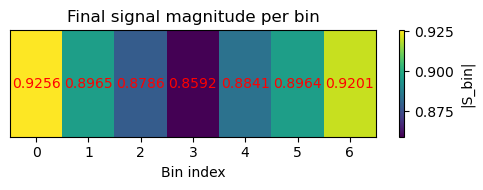

In [15]:
res = simulate_1d_diffusion_store(
    L=L, dt=dt, T_total=T_total, gamma=gamma, G_t=G_t,
    n_spins=n_spins, edges=edges, D_bins=D_bins, seed=seed,
    snapshot_times=snapshot_times
)

S_bins, S_bins_mag = compute_bin_signals_at_end(res, edges)

print("Per-bin signal magnitudes at T_total:")
for i, (Db, Smag) in enumerate(zip(D_bins, S_bins_mag)):
    print(f"bin {i}, D = {Db:.2e} cm^2/ms, |S_bin| = {Smag:.4f}")

snapshots = res["snapshots"]
S_t = res["S_t"]
t_array = res["t_array"]
x_traj = res["x_traj"]
phi_traj = res["phi_traj"]

print("\n|S| at snapshots:")
for st in snapshot_times:
    idx = int(round(st / dt))
    print(f"t = {st} ms: |S| = {abs(S_t[idx]):.4f}")

# final-per-bin heatmap
heat = S_bins_mag[None, :]
fig, ax = plt.subplots(figsize=(5, 2))
im = ax.imshow(heat, aspect="auto", cmap="viridis")
cbar = plt.colorbar(im, ax=ax)
cbar.set_label("|S_bin|")
n_bins = len(S_bins_mag)
ax.set_xticks(range(n_bins))
ax.set_xticklabels([f"{i}" for i in range(n_bins)])
ax.set_yticks([])
ax.set_xlabel("Bin index")
ax.set_title("Final signal magnitude per bin")
for j, val in enumerate(S_bins_mag):
    ax.text(j, 0, f"{val:.4f}", ha="center", va="center", color="red", fontsize=10)
plt.tight_layout()
plt.show()

# Cell 7 — small simulations (n=5) — constant & gradient

In [16]:
# small sim parameters (rest from default)
n_spins_small = 5

# constant-D small sim (use same edges array for plotting consistency)
num_bins = len(edges) - 1
D_const_value = 8e-9
D_bins_const = np.full(num_bins, D_const_value)

res_const = simulate_1d_diffusion_store(
    L=L, dt=dt, T_total=T_total, gamma=gamma, G_t=G_t,
    n_spins=n_spins_small, edges=edges, D_bins=D_bins_const,
    seed=seed + 2, snapshot_times=snapshot_times
)
snapshots_const = res_const["snapshots"]
S_t_const = res_const["S_t"]
t_array_const = res_const["t_array"]
x_traj_const = res_const["x_traj"]
phi_traj_const = res_const["phi_traj"]

print("Constant small sim |S| at snapshots:")
for st in snapshot_times:
    idx = int(round(st / dt))
    print(f"  t = {st} ms: |S| = {abs(S_t_const[idx]):.4f}")

# gradient-D small sim
res_small = simulate_1d_diffusion_store(
    L=L, dt=dt, T_total=T_total, gamma=gamma, G_t=G_t,
    n_spins=n_spins_small, edges=edges, D_bins=D_bins,
    seed=seed + 1, snapshot_times=snapshot_times
)
snapshots_small = res_small["snapshots"]
S_t_small = res_small["S_t"]
t_array_small = res_small["t_array"]
x_traj_small = res_small["x_traj"]
phi_traj_small = res_small["phi_traj"]

print("Gradient small sim |S| at snapshots:")
for st in snapshot_times:
    idx = int(round(st / dt))
    print(f"  t = {st} ms: |S| = {abs(S_t_small[idx]):.4f}")

Constant small sim |S| at snapshots:
  t = 0.0 ms: |S| = 1.0000
  t = 30.0 ms: |S| = 0.9689
  t = 50.0 ms: |S| = 0.9691
  t = 80.0 ms: |S| = 0.4015
Gradient small sim |S| at snapshots:
  t = 0.0 ms: |S| = 1.0000
  t = 30.0 ms: |S| = 0.8992
  t = 50.0 ms: |S| = 0.9004
  t = 80.0 ms: |S| = 0.6337


# Cell 8: constant (small-sim) plotting + animation

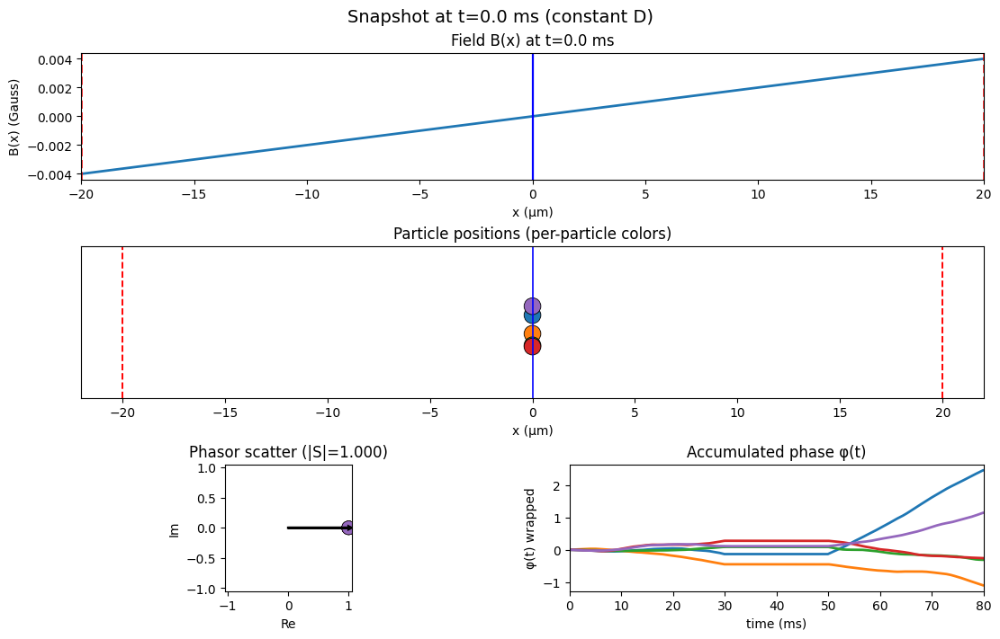

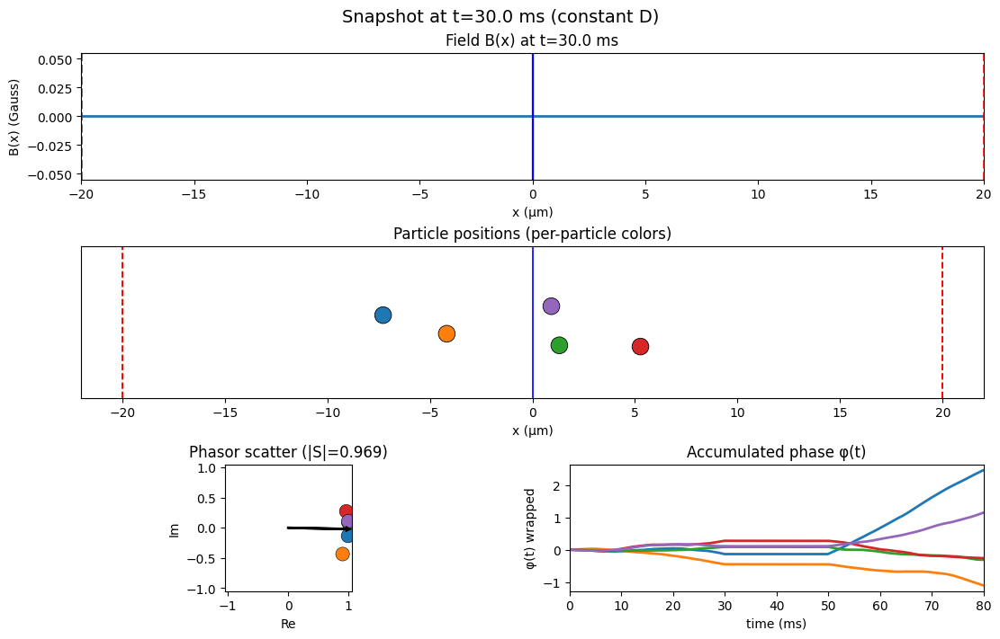

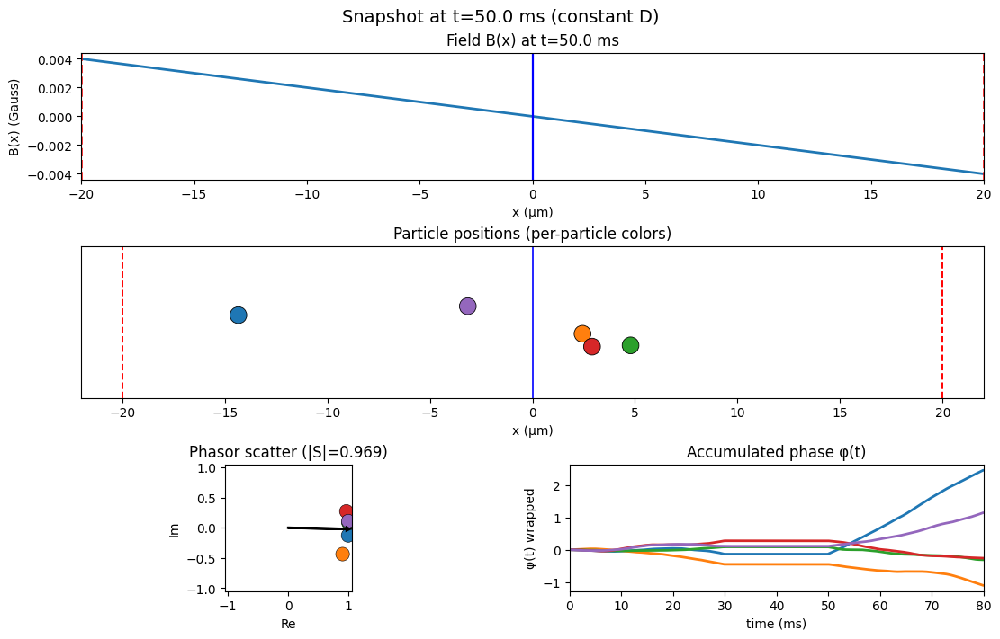

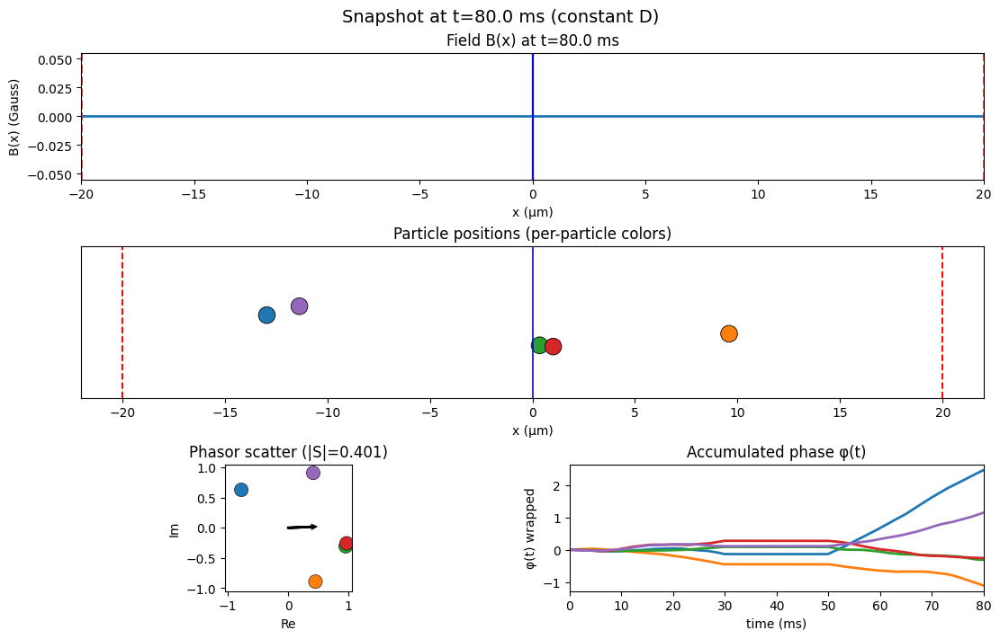

HTML5 animation displayed.
Saved MP4: constant_D_sim.mp4


C:\Users\Shadee Hemaidan\Documents\Python\BENG280A\Grp6_BENG280A_Project_2\constant_D_sim.mp4

C:\Users\Shadee Hemaidan\Documents\Python\BENG280A\Grp6_BENG280A_Project_2\constant_D_sim.gif

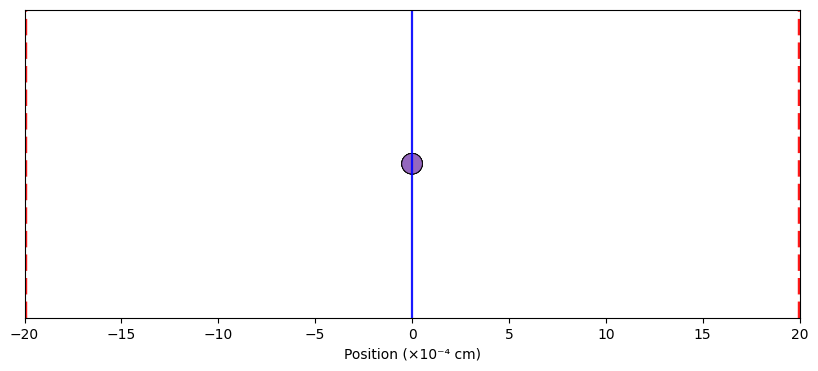

In [14]:
# Constant small-sim plotting & animation
particle_colors_const = [plt.get_cmap("tab10")(i) for i in range(n_spins_small)]

def plot_snapshot_const(snapshot_time, snapshot_data,
                        t_array, S_t, L, edges, phi_traj,
                        cmap_phase='twilight', savefile=None):
    x_snap = snapshot_data["x"]
    phi_snap = snapshot_data["phi"]
    G_current = snapshot_data["G"]

    fig = plt.figure(constrained_layout=True, figsize=(11,7))
    spec = mpl.gridspec.GridSpec(ncols=2, nrows=3, figure=fig,
                                 height_ratios=[1, 1.2, 1.0])

    ax_top = fig.add_subplot(spec[0, :])
    xs = np.linspace(-L/2.0, L/2.0, 400)
    ax_top.plot(xs * 1e4, G_current * xs, lw=2)
    ax_top.set_xlim(-L/2.0*1e4, L/2.0*1e4)
    ax_top.set_xlabel("x (µm)")
    ax_top.set_ylabel("B(x) (Gauss)")
    ax_top.set_title(f"Field B(x) at t={snapshot_time:.1f} ms")

    left_edge  = -L/2 * 1e4
    right_edge =  L/2 * 1e4
    ax_top.axvline(left_edge,  color='red',  linestyle='--', linewidth=1.8)
    ax_top.axvline(right_edge, color='red',  linestyle='--', linewidth=1.8)
    ax_top.axvline(0.0,        color='blue', linestyle='-',  linewidth=1.6)

    ax_mid = fig.add_subplot(spec[1, :])
    rng = np.random.default_rng(0)
    yjit = rng.uniform(-0.02, 0.02, size=len(x_snap))

    ax_mid.scatter(x_snap * 1e4, yjit, s=180, c=particle_colors_const,
                   edgecolors='k', linewidth=0.6)
    ax_mid.axvline(left_edge,  color='red',  linestyle='--', linewidth=1.4)
    ax_mid.axvline(right_edge, color='red',  linestyle='--', linewidth=1.4)
    ax_mid.axvline(0.0,        color='blue', linestyle='-',  linewidth=1.2)
    ax_mid.set_ylim(-0.06, 0.06); ax_mid.set_yticks([])
    ax_mid.set_xlabel("x (µm)"); ax_mid.set_title("Particle positions (per-particle colors)")

    ax_pl = fig.add_subplot(spec[2, 0])
    ax_pl.scatter(np.cos(phi_snap), np.sin(phi_snap), c=particle_colors_const,
                  s=120, edgecolors='k', linewidth=0.4)
    mean_ph = np.mean(np.exp(1j * phi_snap))
    ax_pl.arrow(0,0, mean_ph.real, mean_ph.imag, head_width=0.045, head_length=0.045,
                fc='k', ec='k', linewidth=2)
    ax_pl.set_xlim(-1.05, 1.05); ax_pl.set_ylim(-1.05, 1.05)
    ax_pl.set_aspect('equal'); ax_pl.set_title(f"Phasor scatter (|S|={abs(mean_ph):.3f})")
    ax_pl.set_xlabel("Re"); ax_pl.set_ylabel("Im")

    ax_tr = fig.add_subplot(spec[2, 1])
    phi_wrap = (phi_traj + np.pi) % (2*np.pi) - np.pi
    for i in range(n_spins_small):
        ax_tr.plot(t_array, phi_wrap[:, i], color=particle_colors_const[i], lw=2)
    ax_tr.set_xlim(0, t_array[-1])
    ax_tr.set_xlabel("time (ms)"); ax_tr.set_ylabel("φ(t) wrapped")
    ax_tr.set_title("Accumulated phase φ(t)")

    plt.suptitle(f"Snapshot at t={snapshot_time:.1f} ms (constant D)", fontsize=14)
    if savefile:
        plt.savefig(savefile, dpi=200)
    plt.show()
    return fig

# generate the 4 snapshots
for st in snapshot_times:
    plot_snapshot_const(st, snapshots_const[st], t_array_const, S_t_const, L, edges, phi_traj_const)

# Constant animation
fig_cs, ax_cs = plt.subplots(figsize=(10,4))
ax_cs.set_xlim(-L/2*1e4, L/2*1e4)
ax_cs.set_ylim(-1, 1); ax_cs.set_yticks([]); ax_cs.set_xlabel("Position (×10⁻⁴ cm)")
ax_cs.axvline(0.0, color='blue', linestyle='-', linewidth=1.6, alpha=0.9)
ax_cs.axvline(-L/2.0 * 1e4, color='red', linestyle='--', linewidth=3.2, alpha=0.9)
ax_cs.axvline(L/2.0 * 1e4, color='red', linestyle='--', linewidth=3.2, alpha=0.9)

colormap = plt.get_cmap('tab10')
particle_colors_const = [colormap(i) for i in range(n_spins_small)]
dummy_xc = np.zeros(n_spins_small)
dummy_yc = np.zeros(n_spins_small)
scat_cs = ax_cs.scatter(dummy_xc, dummy_yc, s=220, c=particle_colors_const, edgecolors='k', linewidth=0.6)
title_text = ax_cs.set_title("")

skip = 1
frames = list(range(0, len(x_traj_const), skip))

def init_const():
    scat_cs.set_offsets(np.column_stack((dummy_xc, dummy_yc)))
    title_text.set_text("")
    return scat_cs,

def update_const(frame_idx):
    frame = frames[frame_idx]
    xs = x_traj_const[frame] * 1e4
    ys = np.zeros_like(xs)
    scat_cs.set_offsets(np.column_stack((xs, ys)))
    title_text.set_text(f"5-particle constant-D t = {t_array_const[frame]:.1f} ms")
    return scat_cs,

anim_const = FuncAnimation(fig_cs, update_const, init_func=init_const,
                           frames=len(frames), interval=60, blit=False)

try:
    display(HTML(anim_const.to_jshtml()))
    print("HTML5 animation displayed.")
except Exception as e:
    print("JS animation inline not available:", e)

# Save fallback
try:
    anim_const.save("constant_D_sim.mp4", fps=30, dpi=150, writer="ffmpeg")
    print("Saved MP4: constant_D_sim.mp4")
except Exception as e:
    try:
        anim_const.save("constant_D_sim.gif", fps=20, writer="pillow")
        print("Saved GIF: constant_D_sim.gif")
    except Exception as e2:
        print("Save fallback failed.", e2)

for fname in ["constant_D_sim.mp4", "constant_D_sim.gif"]:
    try:
        display(FileLink(fname))
    except Exception:
        pass

# Cell 9: gradient (small-sim) plotting + animation

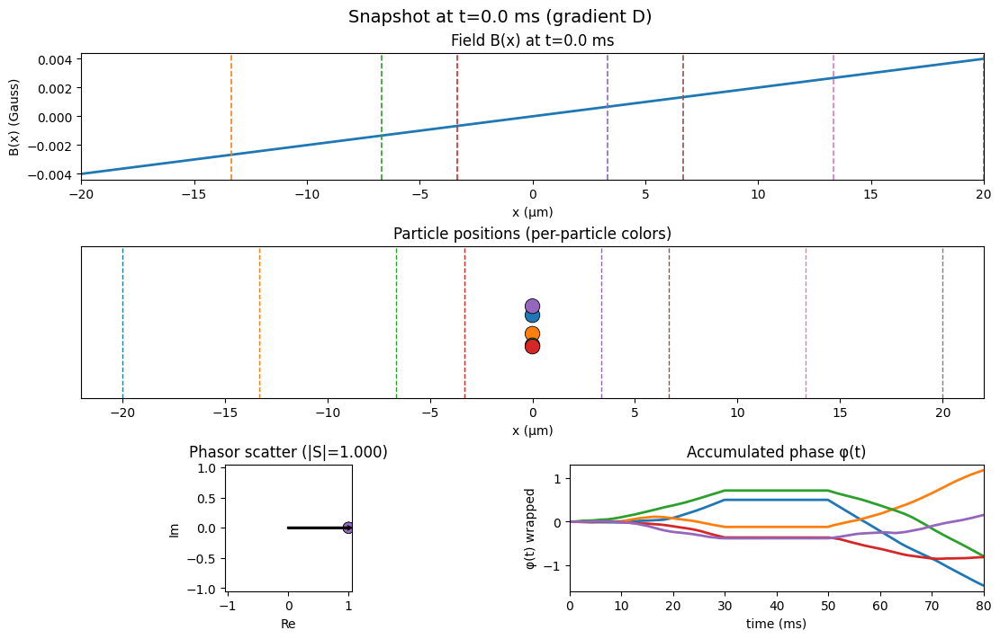

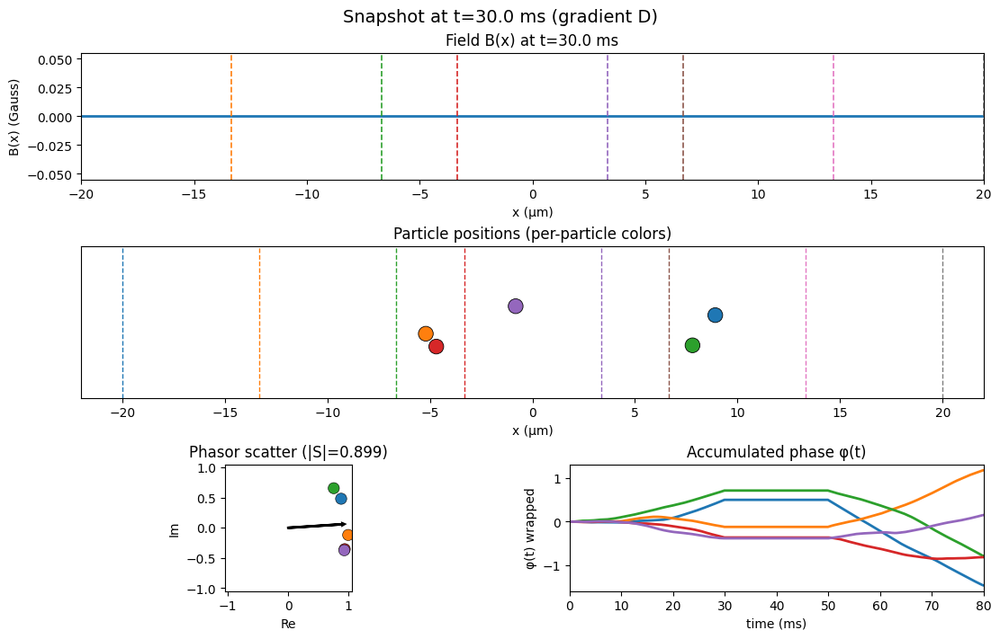

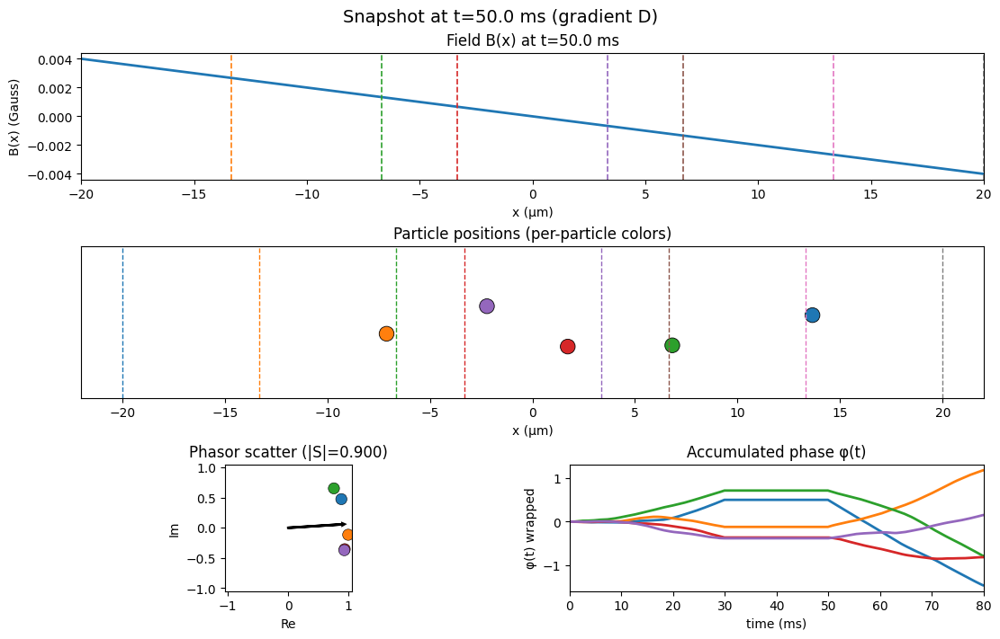

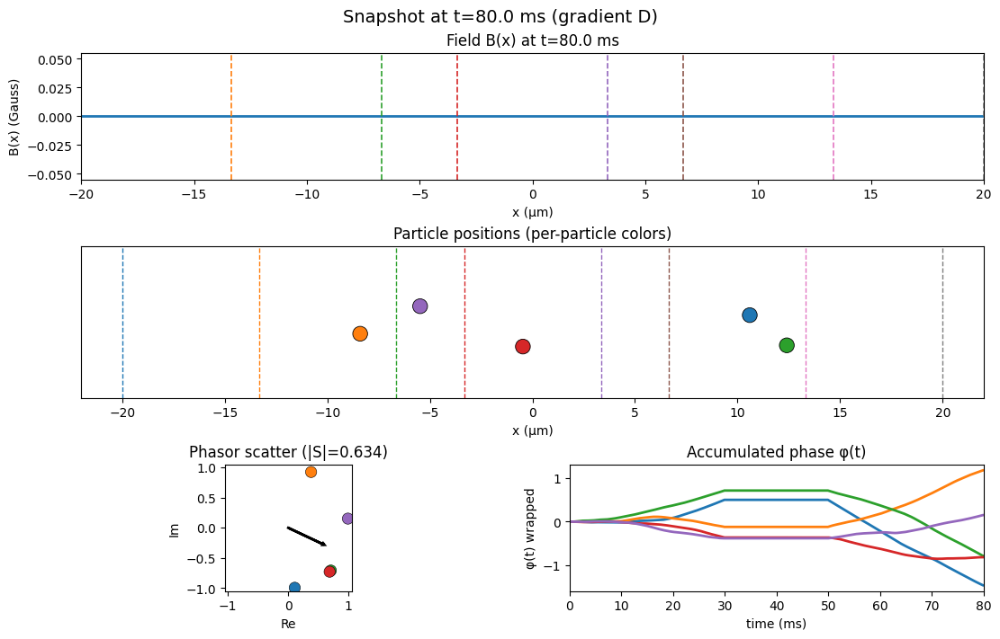

Animation size has reached 20994411 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


HTML5 animation displayed.
Saved MP4: gradient_D_sim.mp4


C:\Users\Shadee Hemaidan\Documents\Python\BENG280A\Grp6_BENG280A_Project_2\gradient_D_sim.mp4

C:\Users\Shadee Hemaidan\Documents\Python\BENG280A\Grp6_BENG280A_Project_2\gradient_D_sim.gif

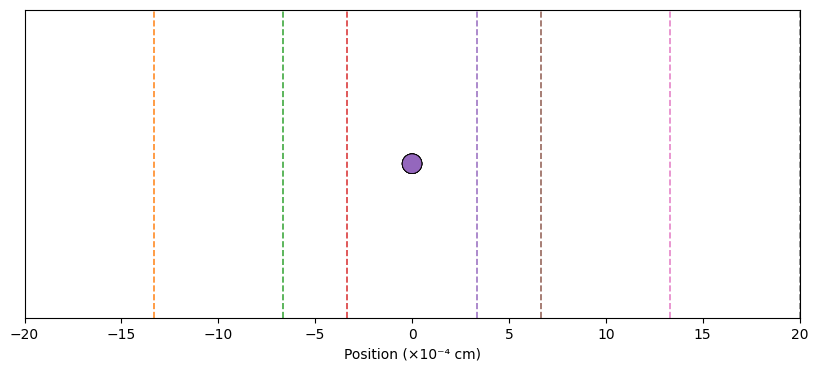

In [15]:
# Gradient small-sim plotting & animation
import matplotlib as mpl
from matplotlib.animation import FuncAnimation
from IPython.display import HTML, FileLink

particle_colors_small = [plt.get_cmap("tab10")(i) for i in range(n_spins_small)]

def plot_snapshot_with_edges(snapshot_time, snapshot_data,
                             t_array, S_t, L, edges, phi_traj,
                             cmap_phase='twilight', savefile=None):
    x_snap = snapshot_data["x"]
    phi_snap = snapshot_data["phi"]
    G_current = snapshot_data["G"]

    fig = plt.figure(constrained_layout=True, figsize=(11,7))
    spec = mpl.gridspec.GridSpec(ncols=2, nrows=3, figure=fig,
                                 height_ratios=[1, 1.2, 1.0])

    ax_top = fig.add_subplot(spec[0,:])
    xs = np.linspace(-L/2, L/2, 400)
    ax_top.plot(xs*1e4, G_current * xs, lw=2)
    ax_top.set_xlim(-L/2*1e4, L/2*1e4)
    ax_top.set_xlabel("x (µm)")
    ax_top.set_ylabel("B(x) (Gauss)")
    ax_top.set_title(f"Field B(x) at t={snapshot_time:.1f} ms")

    cmap_pairs = plt.get_cmap("tab10")
    for i, edge in enumerate(edges):
        ax_top.axvline(edge*1e4, color=cmap_pairs(i%10), linestyle='--', linewidth=1.2)

    ax_mid = fig.add_subplot(spec[1,:])
    rng = np.random.default_rng(0)
    yjit = rng.uniform(-0.02, 0.02, len(x_snap))

    ax_mid.scatter(x_snap * 1e4, yjit, s=140, c=particle_colors_small,
                   edgecolors='k', linewidth=0.6)

    for i, edge in enumerate(edges):
        ax_mid.axvline(edge*1e4, color=cmap_pairs(i%10), linestyle='--', linewidth=1.0)

    ax_mid.set_ylim(-0.06, 0.06)
    ax_mid.set_yticks([])
    ax_mid.set_xlabel("x (µm)")
    ax_mid.set_title("Particle positions (per-particle colors)")

    ax_pl = fig.add_subplot(spec[2,0])
    ax_pl.scatter(np.cos(phi_snap), np.sin(phi_snap), c=particle_colors_small,
                  s=80, edgecolors='k', linewidth=0.4)
    mean_ph = np.mean(np.exp(1j * phi_snap))
    ax_pl.arrow(0,0, mean_ph.real, mean_ph.imag, head_width=0.03, head_length=0.03,
                fc='k', ec='k', linewidth=2)
    ax_pl.set_xlim(-1.05,1.05); ax_pl.set_ylim(-1.05,1.05)
    ax_pl.set_aspect('equal'); ax_pl.set_xlabel("Re"); ax_pl.set_ylabel("Im")
    ax_pl.set_title(f"Phasor scatter (|S|={abs(mean_ph):.3f})")

    ax_tr = fig.add_subplot(spec[2,1])
    phi_wrap = (phi_traj + np.pi) % (2*np.pi) - np.pi
    for i in range(n_spins_small):
        ax_tr.plot(t_array, phi_wrap[:, i], lw=2, color=particle_colors_small[i])
    ax_tr.set_xlim(0, t_array[-1])
    ax_tr.set_xlabel("time (ms)"); ax_tr.set_ylabel("φ(t) wrapped")
    ax_tr.set_title("Accumulated phase φ(t)")

    plt.suptitle(f"Snapshot at t={snapshot_time:.1f} ms (gradient D)", fontsize=14)
    if savefile:
        plt.savefig(savefile, dpi=200)
    plt.show()
    return fig

# Generate the 4 static snapshots (0,30,50,80 ms)
for st in snapshot_times:
    plot_snapshot_with_edges(st, snapshots_small[st], t_array_small, S_t_small, L, edges, phi_traj_small)

# Animation (gradient small sim)
fig_s, ax_s = plt.subplots(figsize=(10,4))
ax_s.set_xlim(-L/2*1e4, L/2*1e4)
ax_s.set_ylim(-1, 1)
ax_s.set_yticks([])
ax_s.set_xlabel("Position (×10⁻⁴ cm)")

cmap_pairs = plt.get_cmap("tab10")
for i, edge in enumerate(edges):
    ax_s.axvline(edge*1e4, color=cmap_pairs(i%10), linestyle='--', linewidth=1.2, alpha=0.9)

colormap = plt.get_cmap('tab10')
particle_colors = [colormap(i) for i in range(n_spins_small)]
dummy_x_small = np.zeros(n_spins_small)
dummy_y_small = np.zeros(n_spins_small)
scat_small = ax_s.scatter(dummy_x_small, dummy_y_small, s=200, c=particle_colors, edgecolors='k', linewidth=0.6)
title_text_s = ax_s.set_title("")

skip = 1
frames = list(range(0, len(x_traj_small), skip))

def init_small_anim():
    scat_small.set_offsets(np.column_stack((dummy_x_small, dummy_y_small)))
    title_text_s.set_text("")
    return scat_small,

def update_small_anim(frame_idx):
    frame = frames[frame_idx]
    xs = x_traj_small[frame] * 1e4
    ys = np.zeros_like(xs)
    scat_small.set_offsets(np.column_stack((xs, ys)))
    title_text_s.set_text(f"5-particle gradient-D t = {t_array_small[frame]:.1f} ms")
    return scat_small,

anim_small = FuncAnimation(fig_s, update_small_anim, init_func=init_small_anim,
                           frames=len(frames), interval=60, blit=False)

try:
    display(HTML(anim_small.to_jshtml()))
    print("HTML5 animation displayed.")
except Exception as e:
    print("JS animation inline not available:", e)

# saving (mp4 needs ffmpeg; gif uses pillow)
try:
    anim_small.save("gradient_D_sim.mp4", fps=30, dpi=150, writer="ffmpeg")
    print("Saved MP4: gradient_D_sim.mp4")
except Exception as e:
    try:
        anim_small.save("gradient_D_sim.gif", fps=20, writer="pillow")
        print("Saved GIF: gradient_D_sim.gif")
    except Exception as e2:
        print("Save fallback failed.", e2)

# quick file links
for fname in ["gradient_D_sim.mp4", "gradient_D_sim.gif"]:
    try:
        display(FileLink(fname))
    except Exception:
        pass

In [17]:
# Save and download MP4/GIF files of animations
from IPython.display import FileLink
FileLink("gradient_D_sim.gif")
FileLink("gradient_D_sim.mp4")
FileLink("constant_D_sim.gif")
FileLink("constant_D_sim.mp4")

C:\Users\Shadee Hemaidan\Documents\Python\BENG280A\Grp6_BENG280A_Project_2\constant_D_sim.mp4